In [39]:
import sys
sys.path.append('../')  
sys.path.append('../model')

from custom_loss_functions import psnr

from tensorflow.keras.models import load_model
from hformer_model import get_hformer_model, PatchExtractor
from skimage.metrics import structural_similarity as ssim

from skimage.util import view_as_blocks

import numpy as np

from skimage.metrics import peak_signal_noise_ratio

import tensorflow as tf
from tensorflow import keras
from keras import layers, models
from keras import backend as K

from sklearn.model_selection import train_test_split

from data_importer import load_testing_images
from data_importer import load_training_images, denormalize, trunc

import matplotlib.pyplot as plt


In [40]:
# Common testing image pairs (used to evaluate all models)

noisy_images, ground_truth_images = load_training_images('../../../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data', load_limited_images=True, num_images_to_load=10)

patch_extractor = PatchExtractor(patch_size=64, stride=64, name="patch_extractor")
test_image_patches = patch_extractor(noisy_images)

loaded training images x and y of len :  10 10  respectively
type of train images x :  float64
range of values in train images :  0.0 0.576171875
type of train images y :  float64


In [41]:
test_images_with_no_ground_truth = load_testing_images('../../../../../../Dataset/LowDoseCTGrandChallenge/Testing_Image_Data', load_limited_images=True, num_images_to_load=5)
test_image_with_no_gt_patches = patch_extractor(test_images_with_no_ground_truth)

loaded testing images x of len :  5
type of test images x :  float64
range of values in test images :  0.0 0.619140625


Code for evaluation of model(s)

In [42]:
def view_model_history(history, psnr_or_accuracy):
    # Visualize model history.
    print('history keys : ', history.keys())

    # Plot loss, accuracy, val_loss and val_accuracy

    # Get the number of epochs
    num_epochs = len(history['loss'])

    # Plot training and validation accuracy / PSNR values
    if psnr_or_accuracy == 'accuracy':
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['accuracy'], label='Training Accuracy')
        plt.plot(range(1, num_epochs + 1), history['val_accuracy'], label='Validation Accuracy')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
    elif psnr_or_accuracy == 'psnr':
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['psnr'], label='Training psnr')
        plt.plot(range(1, num_epochs + 1), history['val_psnr'], label='Validation psnr')
        plt.title('Training and Validation Psnr')
        plt.xlabel('Epoch')
        plt.ylabel('Psnr')
        plt.legend()
        
    # Plot training and validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs + 1), history['loss'], label='Training Loss')
    plt.plot(range(1, num_epochs + 1), history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

In [43]:
def reconstruct_image_from_patches(patches, num_patches_per_row):
    patch_size = patches.shape[1]  # Assuming square patches
    num_patches = patches.shape[0]

    # Calculate the number of rows
    num_patches_per_col = num_patches // num_patches_per_row

    # Initialize an empty image to store the reconstructed result
    reconstructed_image = np.zeros((num_patches_per_col * patch_size, num_patches_per_row * patch_size))

    # Reshape the patches into a 2D array
    patches_2d = patches.reshape((num_patches_per_col, num_patches_per_row, patch_size, patch_size))

    # Reconstruct the image by placing each patch in its corresponding position
    for i in range(num_patches_per_col):
        for j in range(num_patches_per_row):
            reconstructed_image[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size] = patches_2d[i, j]

    return np.expand_dims(reconstructed_image, axis=-1)



In [44]:
def calculate_psnr(original_image, reconstructed_image):
    psnr_value = peak_signal_noise_ratio(original_image, reconstructed_image, data_range=240+160)
    return psnr_value

def calculate_ssim(original_image, reconstructed_image):    
    ssim_value = ssim(original_image.astype(np.float32), reconstructed_image.astype(np.float32), win_size=7,  channel_axis=2, data_range=240+160)
    return ssim_value



In [45]:
def visualize_patches(patches, noisy_images,  ground_truth_images, num_images):
    num_patches_per_image = int(patches.shape[0] / num_images)

    print('patches per image : ', num_patches_per_image)

    print('datatype of patches : ', patches.dtype)

    for i in range(num_images):
        print('this image has start patches : ', i * num_patches_per_image)
        image_patches = patches[i * num_patches_per_image:i * num_patches_per_image + num_patches_per_image]

        fig, axes = plt.subplots(1, 4, figsize=(30, 30))
        axes = axes.flatten()
        
        reconstruct_image = trunc(1500 * (reconstruct_image_from_patches(image_patches, 8)))
        _noisy_image = trunc(denormalize(noisy_images[i]))
        _clean_image = trunc(denormalize(ground_truth_images[i]))
        
        print('range of reconstructed image : ', np.min(reconstruct_image), np.max(reconstruct_image))
        print('reconstruct_image shape : ', reconstruct_image.shape)
        print('noisy image shape : ', noisy_images[i].shape)
        
        axes[0].set_title('input image')
        axes[0].imshow(_noisy_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[0].axis('off')
        
        axes[1].set_title('ground truth image')
        axes[1].imshow(_clean_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[1].axis('off')
        
        axes[2].set_title('model prediction')
        axes[2].imshow(reconstruct_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[2].axis('off')
        
        axes[3].set_title('removed noise')
        axes[3].imshow((_noisy_image - reconstruct_image), cmap='gray')
        axes[3].axis('off')
        
        print('PSNR of reconsturcted image : ', calculate_psnr(_clean_image, reconstruct_image))
        print('PSNR of noisy image : ', calculate_psnr(_clean_image, _noisy_image))
        print('SSIM of noisy image : ', calculate_ssim(_clean_image, _noisy_image))
        print('SSIM of reconstructed image : ', calculate_ssim(_clean_image, reconstruct_image))
        
        plt.show()


In [46]:
def visualize_patches_with_no_gt(patches, noisy_images, num_images):
    num_patches_per_image = int(patches.shape[0] / num_images)

    print('datatype of patches : ', patches.dtype)
    
    print('patches per image : ', num_patches_per_image)

    for i in range(num_images):
        print('this image has start patches : ', i * num_patches_per_image)
        image_patches = patches[i * num_patches_per_image:i * num_patches_per_image + num_patches_per_image]

        fig, axes = plt.subplots(1, 3, figsize=(28, 28))
        axes = axes.flatten()
        
        reconstruct_image = reconstruct_image_from_patches(image_patches, 8)
 
        print('range of reconstructed image : ', np.min(reconstruct_image), np.max(reconstruct_image))
        print('reconstruct_image shape : ', reconstruct_image.shape)
        print('noisy image shape : ', noisy_images[i].shape)
        
        noisy = trunc(denormalize(noisy_images[i]))
        
        axes[0].set_title('input image')
        axes[0].imshow(noisy, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[0].axis('off')
                
        axes[1].set_title('model prediction')
        axes[1].imshow(reconstruct_image, cmap='gray', vmin=-160.0, vmax=240.0)
        axes[1].axis('off')
        
        axes[2].set_title('removed noise')
        axes[2].imshow((noisy - reconstruct_image), cmap='gray')
        axes[2].axis('off')

        print('PSNR of reconsturcted image : ', calculate_psnr(trunc(denormalize(ground_truth_images[i])), trunc(denormalize(reconstruct_image))))
        print('SSIM of reconstructed image : ', calculate_ssim(trunc(denormalize(ground_truth_images[i])), trunc(denormalize(reconstruct_image))))

        plt.show()


In [47]:
def evaluate_model(model, history, name, psnr_or_accuracy):
    print('Training history of model : ', name)
    view_model_history(history, psnr_or_accuracy)
    
    print('Model prediction test')
    
    predictions = model.predict(test_image_patches)
    visualize_patches(predictions, noisy_images, ground_truth_images, len(noisy_images))
    print('\n\n\n\n\n')
    
    print('Model prediction test on blind images')    
    predictions = model.predict(test_image_with_no_gt_patches)
    visualize_patches_with_no_gt(predictions, test_images_with_no_ground_truth, len(test_images_with_no_ground_truth))
    print('\n\n\n\n\n')
    

NOTE : The below cell is a workbench
Testing if per-epoch .h5 files are useful for testing purposes.
Currently using custom loss function (1 - SSIM) + MSE

Model: "hformer_model_extended_64_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

Training history of model :  hformer_64_extended_partial_epoch
history keys :  dict_keys(['loss', 'psnr', 'val_loss', 'val_psnr'])


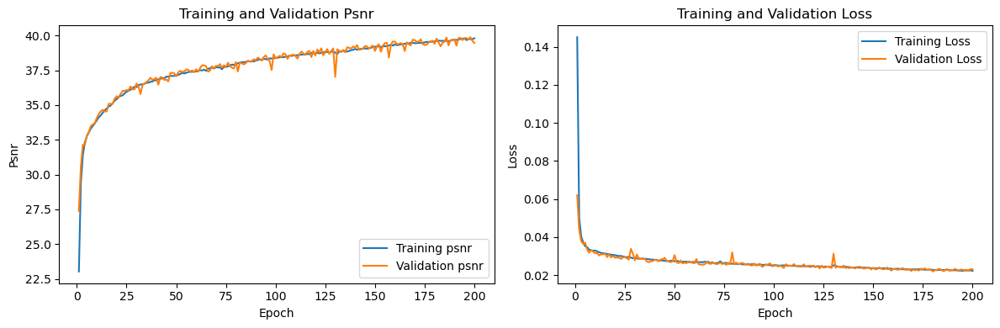

Model prediction test
20/20 [==============================] - 3s 146ms/step
patches per image :  64
datatype of patches :  float32
this image has start patches :  0
range of reconstructed image :  -9.540059370920062 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.306070924148577
PSNR of noisy image :  23.485824280503806
SSIM of noisy image :  0.8430164
SSIM of reconstructed image :  -0.15454735


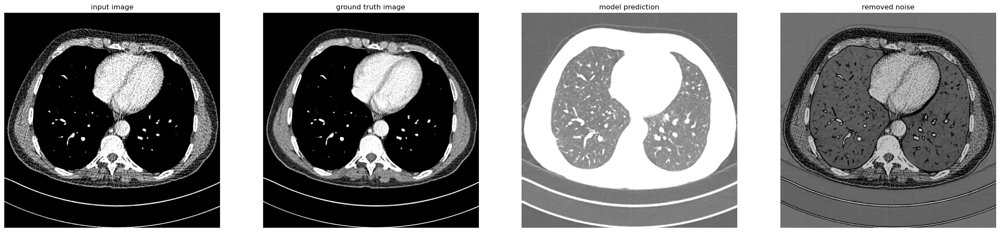

this image has start patches :  64
range of reconstructed image :  -9.031217079609632 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.294362755897404
PSNR of noisy image :  23.77072744405735
SSIM of noisy image :  0.8466024
SSIM of reconstructed image :  -0.15703326


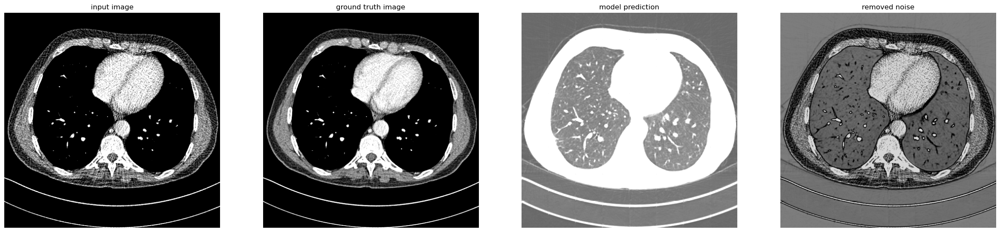

this image has start patches :  128
range of reconstructed image :  -8.838237030431628 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.290146298836137
PSNR of noisy image :  23.872244369711602
SSIM of noisy image :  0.84596694
SSIM of reconstructed image :  -0.157925


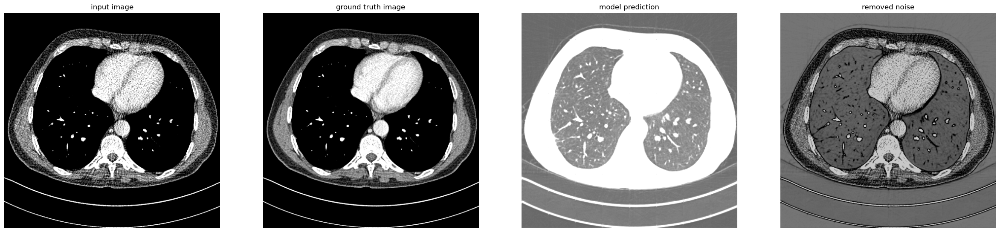

this image has start patches :  192
range of reconstructed image :  -9.793617529794574 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.2867083701334945
PSNR of noisy image :  23.68181948637809
SSIM of noisy image :  0.84348005
SSIM of reconstructed image :  -0.15852848


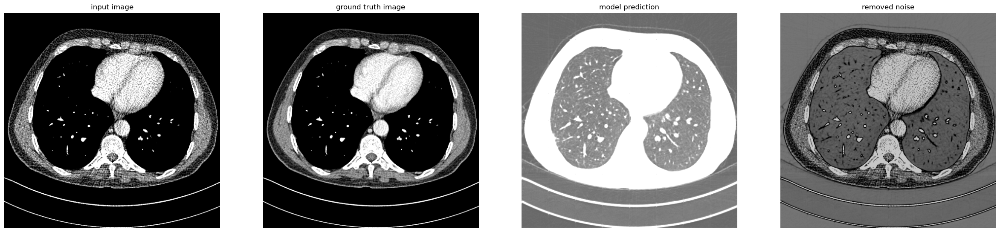

this image has start patches :  256
range of reconstructed image :  -8.403625572100282 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.278352934811325
PSNR of noisy image :  23.979451548330296
SSIM of noisy image :  0.8488928
SSIM of reconstructed image :  -0.16079502


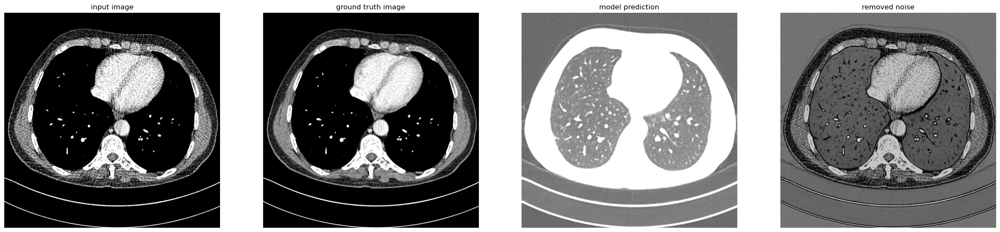

this image has start patches :  320
range of reconstructed image :  -11.39694987796247 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.2713968662173425
PSNR of noisy image :  24.178606306101663
SSIM of noisy image :  0.8512244
SSIM of reconstructed image :  -0.16336226


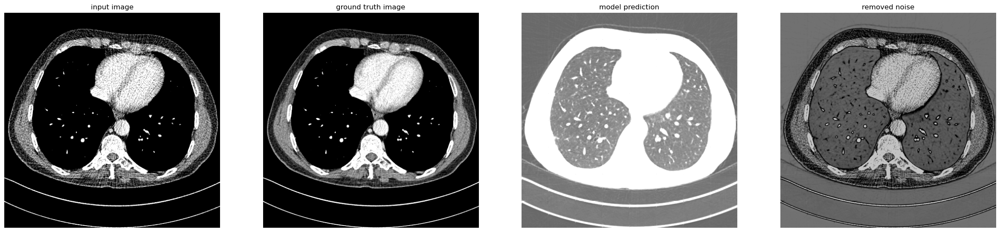

this image has start patches :  384
range of reconstructed image :  -15.804626047611237 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.262155365998091
PSNR of noisy image :  23.928403306314998
SSIM of noisy image :  0.8495585
SSIM of reconstructed image :  -0.16283287


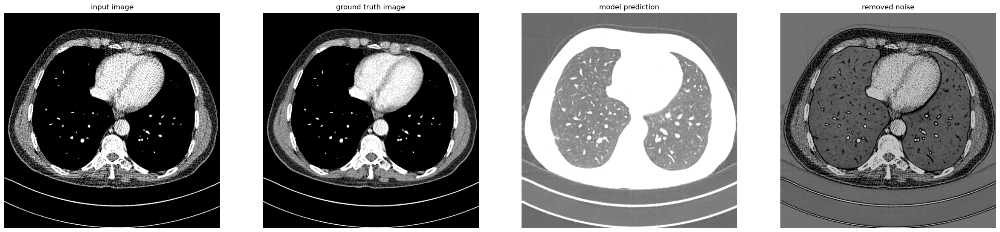

this image has start patches :  448
range of reconstructed image :  -10.894140461459756 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.2497810801753095
PSNR of noisy image :  24.188060278312804
SSIM of noisy image :  0.85253966
SSIM of reconstructed image :  -0.16587701


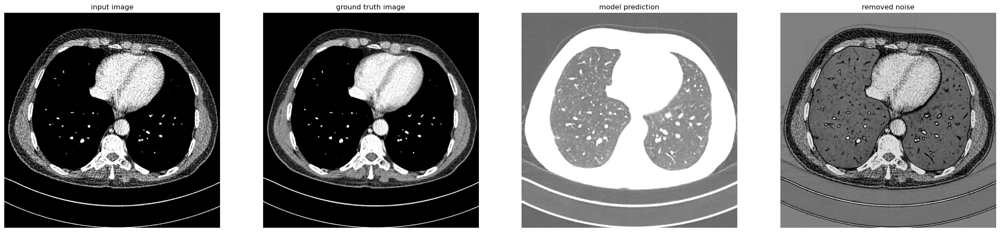

this image has start patches :  512
range of reconstructed image :  -10.235142661258578 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.240412453675623
PSNR of noisy image :  24.267820089605138
SSIM of noisy image :  0.85317534
SSIM of reconstructed image :  -0.16701679


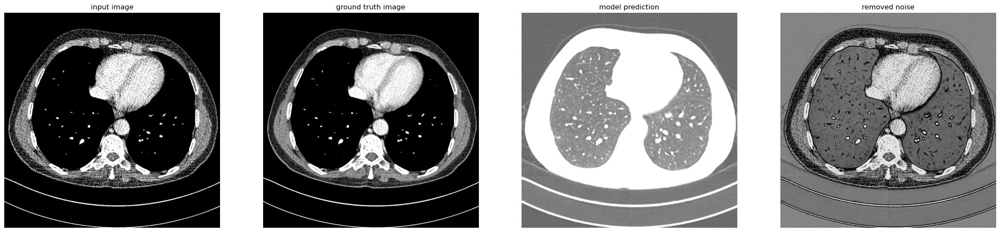

this image has start patches :  576
range of reconstructed image :  -11.318524600937963 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  5.226058737104141
PSNR of noisy image :  24.01930346507163
SSIM of noisy image :  0.8521291
SSIM of reconstructed image :  -0.1660616


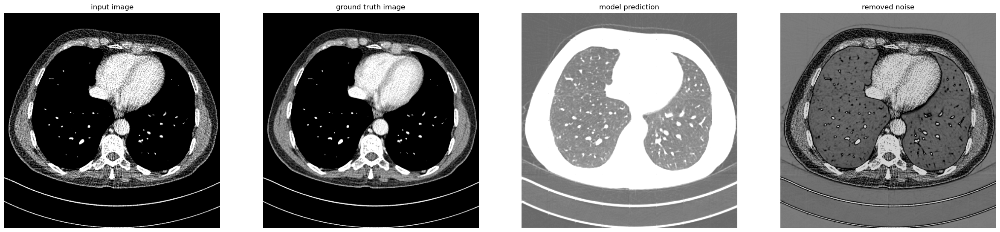







Model prediction test on blind images
10/10 [==============================] - 2s 167ms/step
datatype of patches :  float32
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -0.004253000486642122 0.6175215244293213
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.758581641821447
SSIM of reconstructed image :  0.51676244


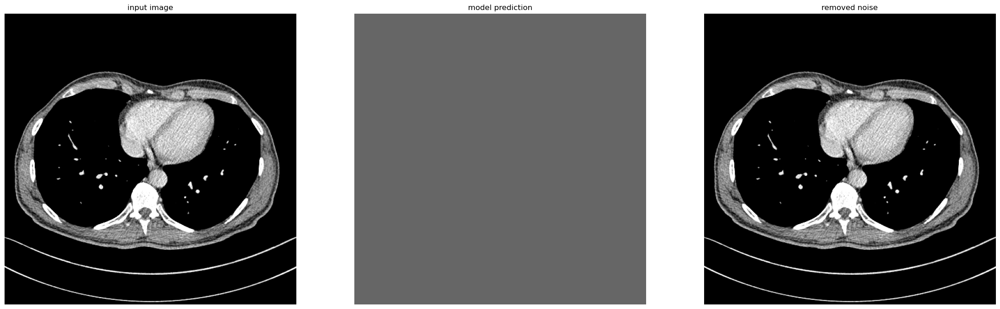

this image has start patches :  64
range of reconstructed image :  -0.004433537367731333 0.6168603897094727
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.773137331452961
SSIM of reconstructed image :  0.5178451


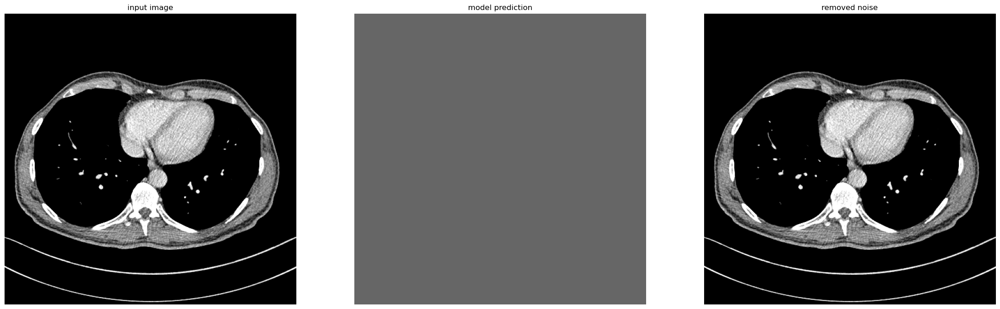

this image has start patches :  128
range of reconstructed image :  -0.004281847737729549 0.6147812604904175
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.783503353274543
SSIM of reconstructed image :  0.5193132


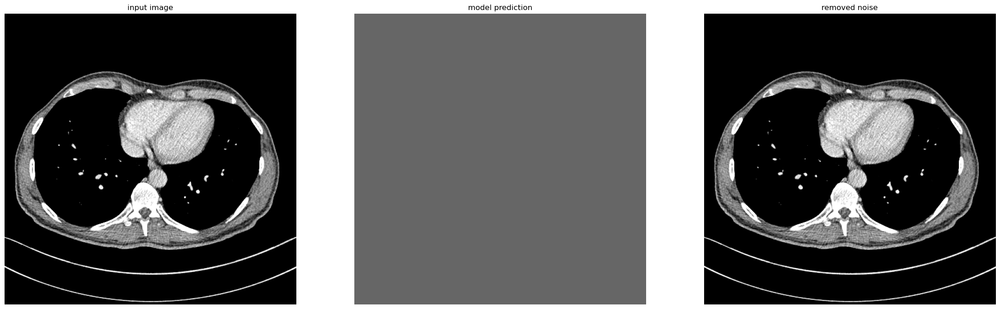

this image has start patches :  192
range of reconstructed image :  -0.00458884472027421 0.593731164932251
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.797971897998424
SSIM of reconstructed image :  0.520825


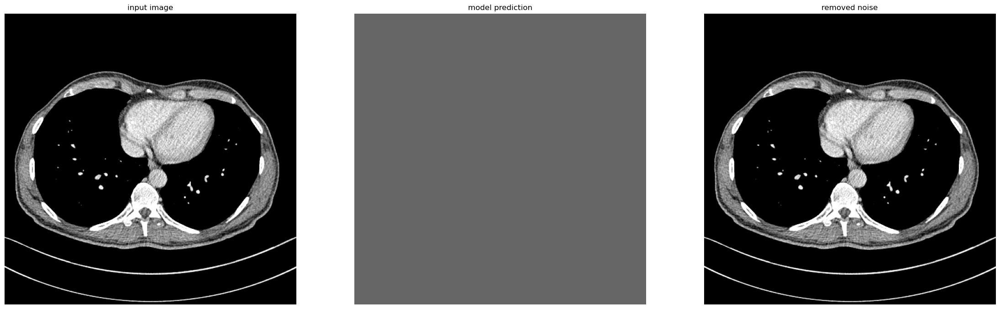

this image has start patches :  256
range of reconstructed image :  -0.005296576302498579 0.5829355716705322
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.835038340286683
SSIM of reconstructed image :  0.5219786


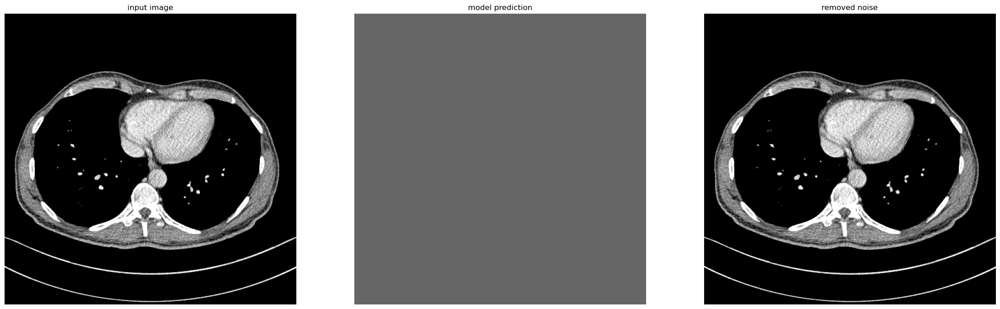

In [48]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended_64_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('../data/hformer_64_channel_custom_loss_epochs_33.h5')
history = np.load('../data/saved_weights_and_history/hformer_200_epoch_history_extended_64_channel_custom_loss.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_64_extended_partial_epoch', 'psnr')

Test with the 'Small' version of hformer (16 channels), ~61K learnable parameters

In [49]:
# Get model and build (required for loading weights).
from hformer_model import get_hformer_model

model = get_hformer_model(num_channels_to_be_generated=16, name="hformer_model")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_25_epoch_16_channel_full_dataset.h5')
history = np.load('saved_weights_and_history/hformer_25_epoch_16_channel_full_datasethistory.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_16_channel_small', 'accuracy')

Model: "hformer_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 160       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 145       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 1376      
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 1376      
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  multiple               

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = 'saved_weights_and_history/hformer_25_epoch_16_channel_full_dataset.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

Evaluation of Hformer extended Medium (48 channel), ~850K learnable parameters

Model: "hformer_model_extended_48_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 240       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 193       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

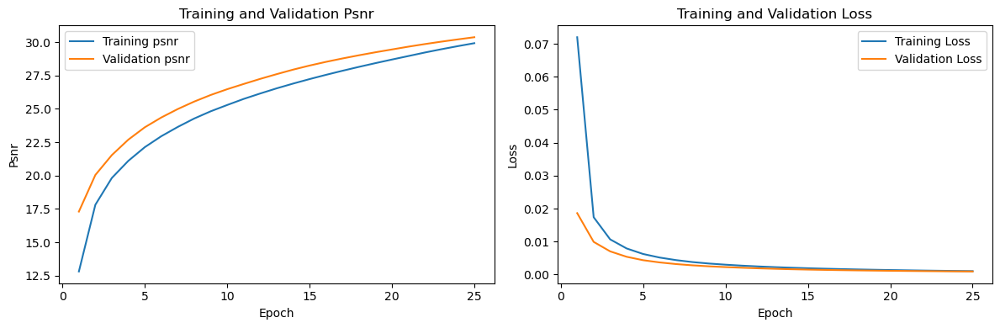

Model prediction test
20/20 [==============================] - 3s 91ms/step
patches per image :  64
datatype of patches :  float32
this image has start patches :  0
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.235756483701817
PSNR of noisy image :  23.485824280503806
SSIM of noisy image :  0.8430164
SSIM of reconstructed image :  0.71327984


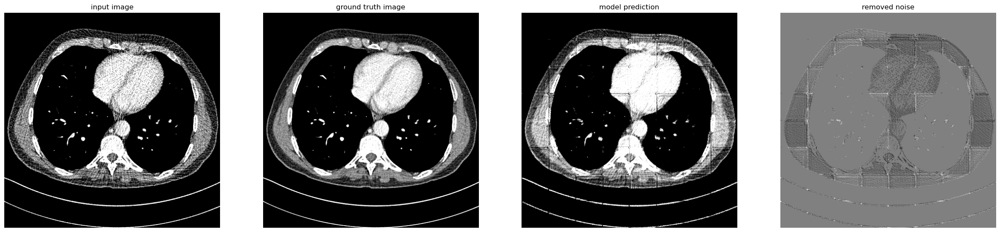

this image has start patches :  64
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.268418666770632
PSNR of noisy image :  23.77072744405735
SSIM of noisy image :  0.8466024
SSIM of reconstructed image :  0.71343815


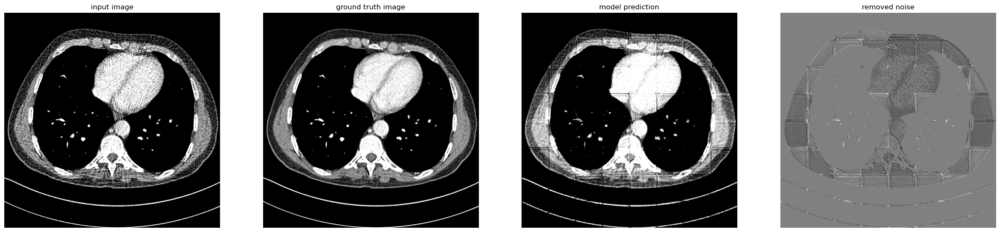

this image has start patches :  128
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.308942377414958
PSNR of noisy image :  23.872244369711602
SSIM of noisy image :  0.84596694
SSIM of reconstructed image :  0.71472937


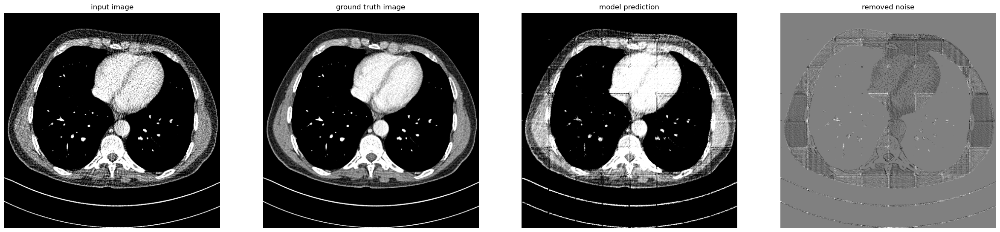

this image has start patches :  192
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.298364595520454
PSNR of noisy image :  23.68181948637809
SSIM of noisy image :  0.84348005
SSIM of reconstructed image :  0.71332425


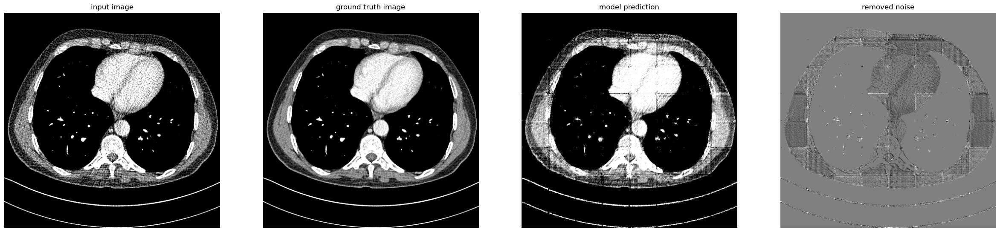

this image has start patches :  256
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.32543163936341
PSNR of noisy image :  23.979451548330296
SSIM of noisy image :  0.8488928
SSIM of reconstructed image :  0.71431583


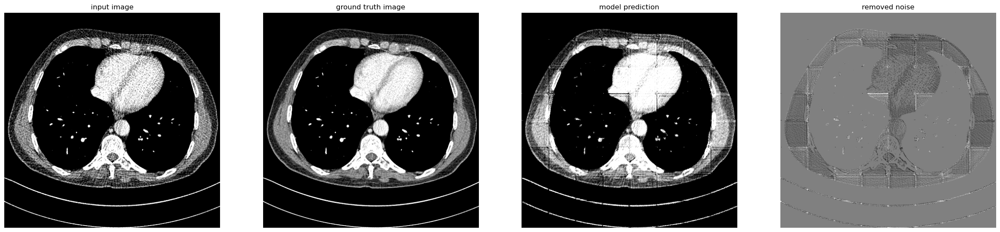

this image has start patches :  320
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.389541460448832
PSNR of noisy image :  24.178606306101663
SSIM of noisy image :  0.8512244
SSIM of reconstructed image :  0.717687


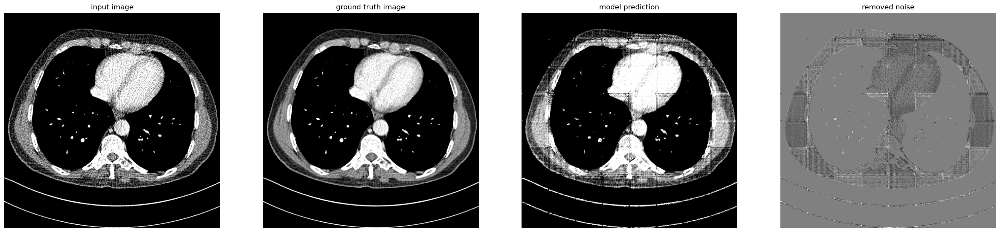

this image has start patches :  384
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.364829935020186
PSNR of noisy image :  23.928403306314998
SSIM of noisy image :  0.8495585
SSIM of reconstructed image :  0.7178187


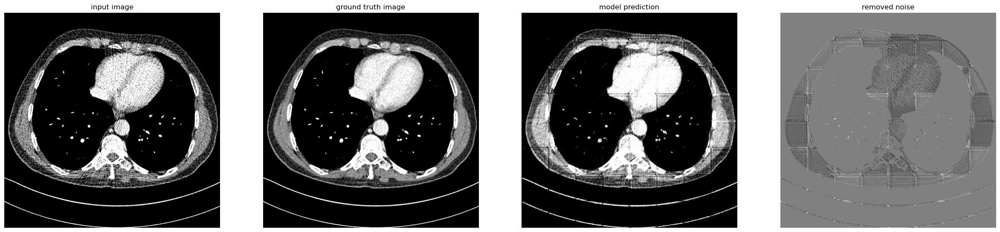

this image has start patches :  448
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.42125286217108
PSNR of noisy image :  24.188060278312804
SSIM of noisy image :  0.85253966
SSIM of reconstructed image :  0.71890247


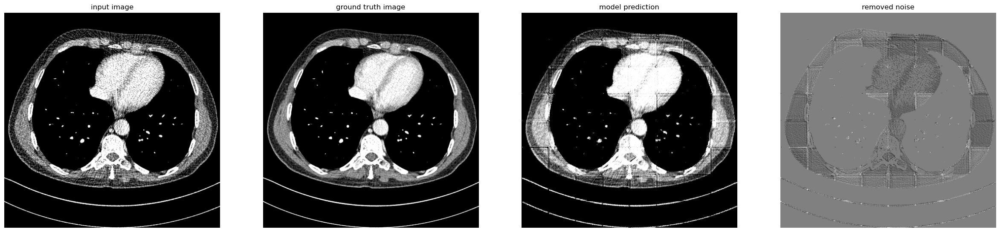

this image has start patches :  512
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.453580416266043
PSNR of noisy image :  24.267820089605138
SSIM of noisy image :  0.85317534
SSIM of reconstructed image :  0.71905255


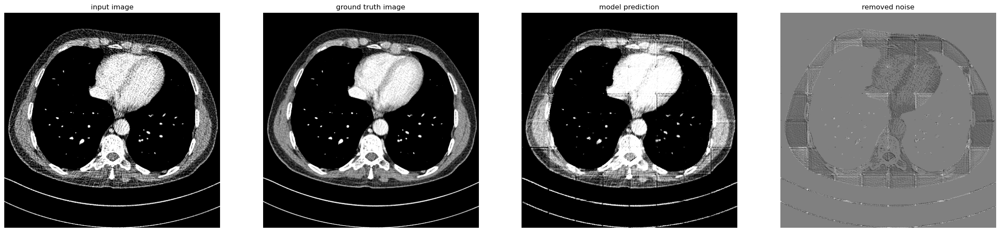

this image has start patches :  576
range of reconstructed image :  -160.0 240.0
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  17.447965989383473
PSNR of noisy image :  24.01930346507163
SSIM of noisy image :  0.8521291
SSIM of reconstructed image :  0.7177456


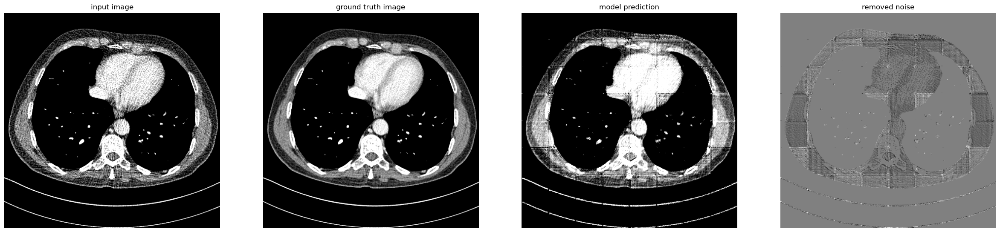







Model prediction test on blind images
10/10 [==============================] - 1s 121ms/step
datatype of patches :  float32
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -0.16484083235263824 0.6340979933738708
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.219642693066156
SSIM of reconstructed image :  0.51080257


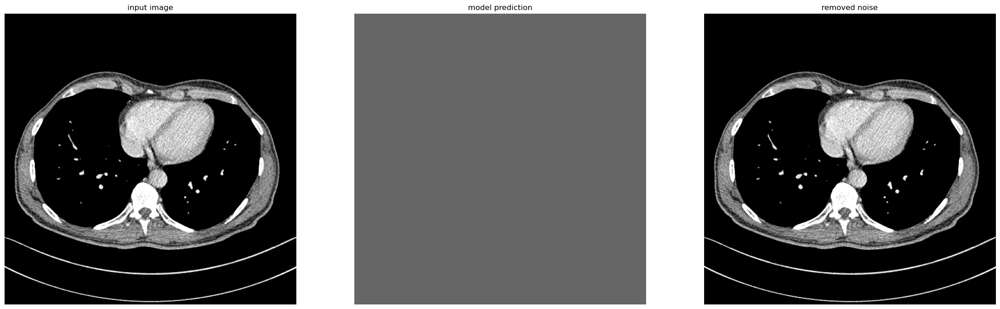

this image has start patches :  64
range of reconstructed image :  -0.16914743185043335 0.6401082277297974
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.238377958335775
SSIM of reconstructed image :  0.5122707


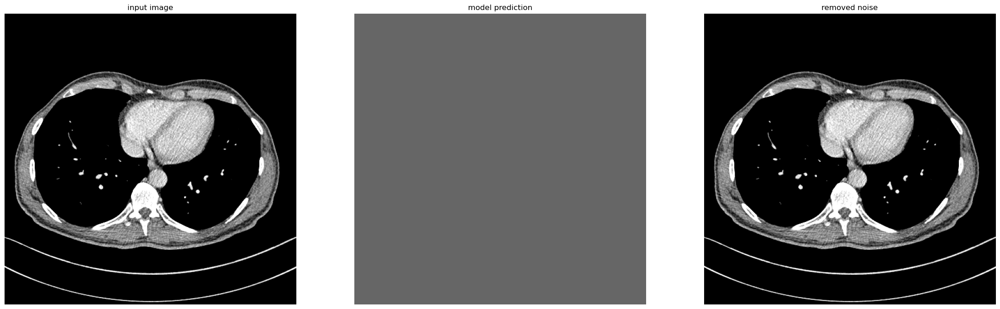

this image has start patches :  128
range of reconstructed image :  -0.170680433511734 0.621779203414917
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.24576294803227
SSIM of reconstructed image :  0.5132808


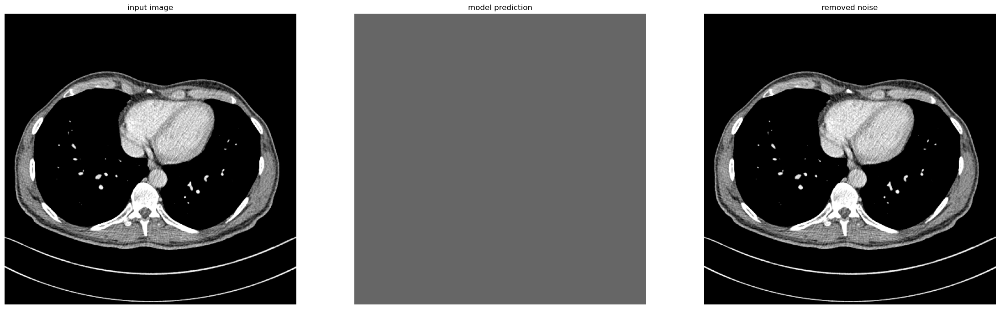

this image has start patches :  192
range of reconstructed image :  -0.16130197048187256 0.605466365814209
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.25293788915311
SSIM of reconstructed image :  0.5151552


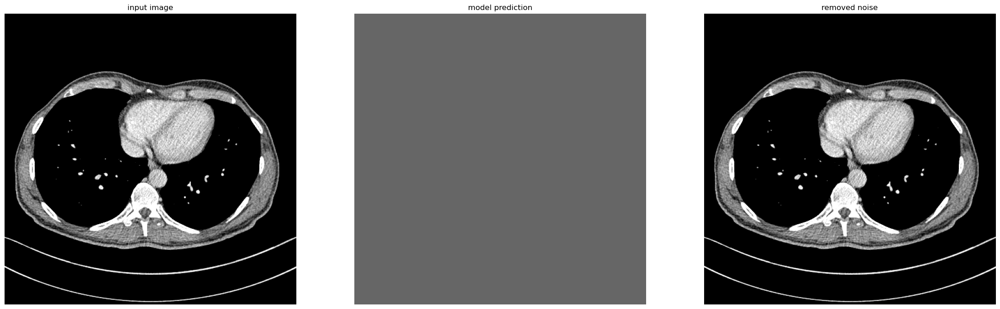

this image has start patches :  256
range of reconstructed image :  -0.16326045989990234 0.6053165197372437
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  10.280614623478678
SSIM of reconstructed image :  0.51607436


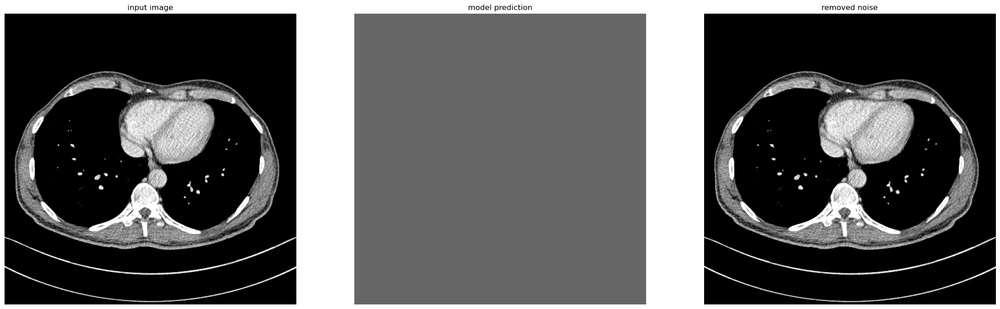

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=48, name="hformer_model_extended_48_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_25_epoch_extended_48_channel.h5')
history = np.load('saved_weights_and_history/hformer_25_epoch_history_extended_48_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'psnr')

Test with hformer medium 30 epoch (~850K parameters but using accuracy as metric instead of PSNR)

Model: "hformer_model_extended_48_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 240       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 193       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 21168     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

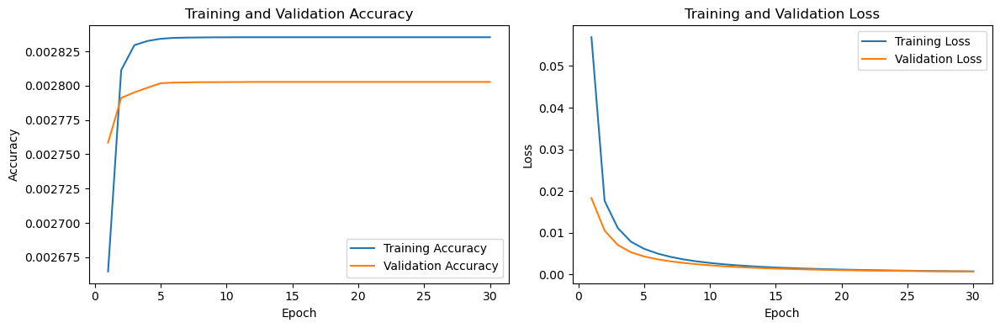

Model prediction test
18/20 [==========================>...] - ETA: 0s

KeyboardInterrupt: 

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=48, name="hformer_model_extended_48_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_30_epoch_extended_48_channel.h5')
history = np.load('saved_weights_and_history/hformer_30_epoch_history_extended_48_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'accuracy')

Test with hformer large 40 epoch (~1.5M parameters, trained on full dataset with psnr as metric)

Model: "hformer_model_extended_64_channel"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv2  mul

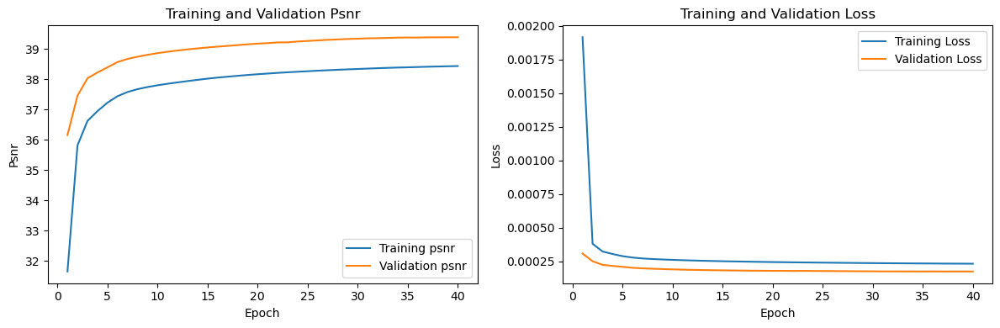

Model prediction test
20/20 [==============================] - 4s 165ms/step
patches per image :  64
datatype of patches :  float32
this image has start patches :  0
range of reconstructed image :  -0.006666586268693209 0.8740199208259583
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  38.97019028915183
PSNR of noisy image :  35.600297920932945
SSIM of noisy image :  0.8751545
SSIM of reconstructed image :  0.9383967


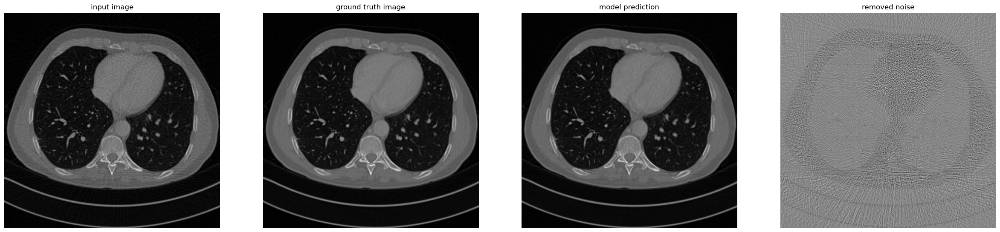

this image has start patches :  64
range of reconstructed image :  -0.0036330311559140682 0.8915669322013855
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.177857976811175
PSNR of noisy image :  35.84850443503983
SSIM of noisy image :  0.88206375
SSIM of reconstructed image :  0.94147146


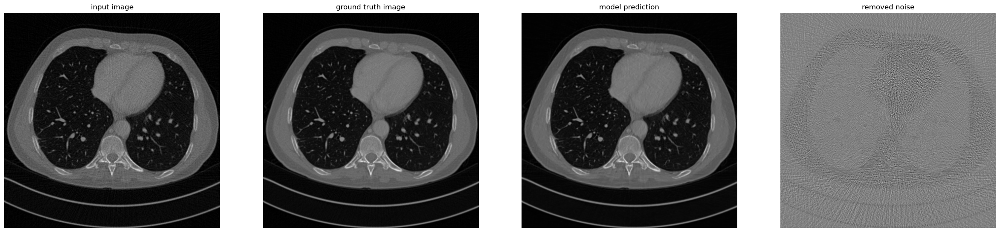

this image has start patches :  128
range of reconstructed image :  -0.004642984364181757 0.8601873517036438
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.26846390031074
PSNR of noisy image :  35.94381337057423
SSIM of noisy image :  0.88362473
SSIM of reconstructed image :  0.94244415


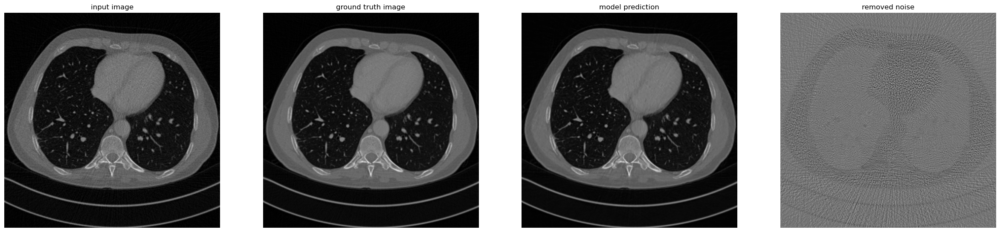

this image has start patches :  192
range of reconstructed image :  -0.005993845406919718 0.9049400687217712
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.16206805809752
PSNR of noisy image :  35.80295137061293
SSIM of noisy image :  0.8803377
SSIM of reconstructed image :  0.9410616


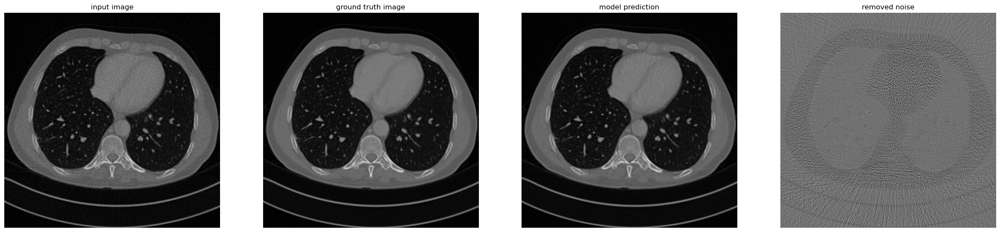

this image has start patches :  256
range of reconstructed image :  -0.00552479038015008 0.9052478671073914
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.4142381178311
PSNR of noisy image :  36.031714880289194
SSIM of noisy image :  0.8857574
SSIM of reconstructed image :  0.9444214


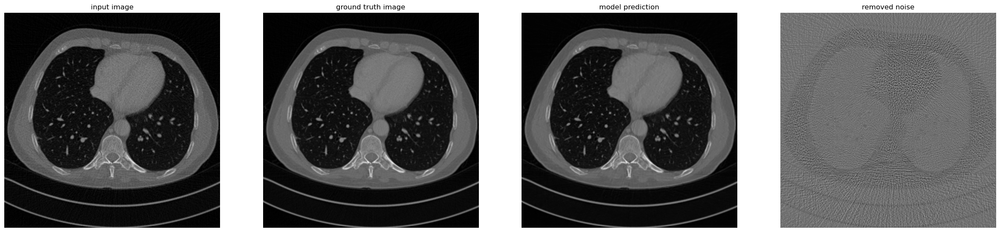

this image has start patches :  320
range of reconstructed image :  -0.0033871536143124104 0.9254003763198853
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.466817803996015
PSNR of noisy image :  36.14461720214498
SSIM of noisy image :  0.8884423
SSIM of reconstructed image :  0.945187


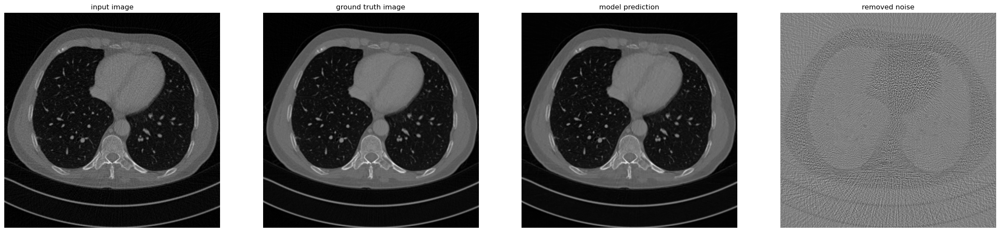

this image has start patches :  384
range of reconstructed image :  -0.003868765663355589 0.971359133720398
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.282609803403226
PSNR of noisy image :  35.89484727398816
SSIM of noisy image :  0.88258916
SSIM of reconstructed image :  0.9427929


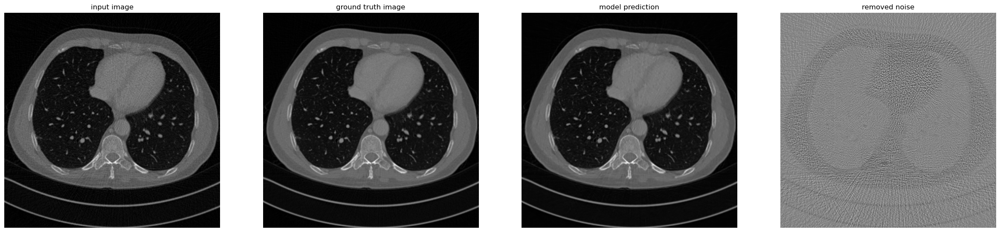

this image has start patches :  448
range of reconstructed image :  -0.0026800567284226418 0.9758231043815613
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.622552902215034
PSNR of noisy image :  36.22792618702719
SSIM of noisy image :  0.8901621
SSIM of reconstructed image :  0.94658095


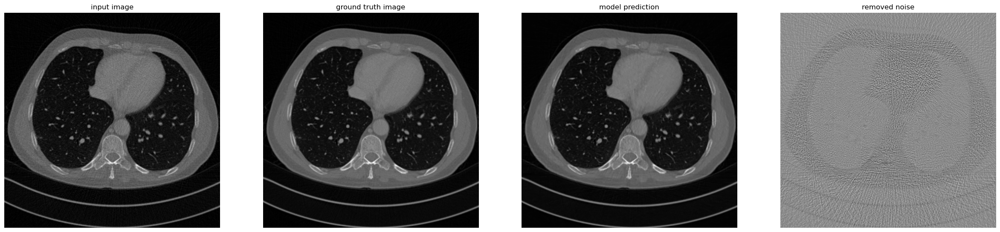

this image has start patches :  512
range of reconstructed image :  -0.0031045391224324703 0.9737979173660278
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.74555475045362
PSNR of noisy image :  36.32200486139171
SSIM of noisy image :  0.8920069
SSIM of reconstructed image :  0.94773346


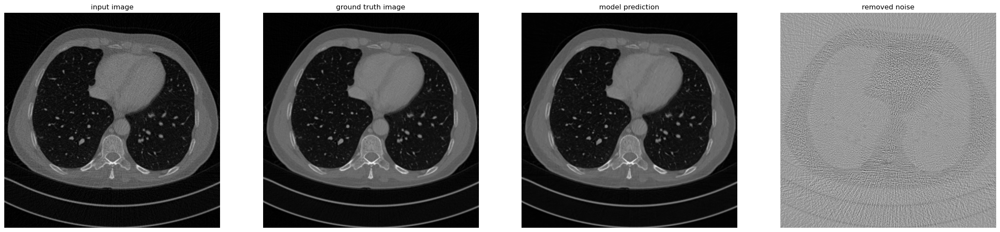

this image has start patches :  576
range of reconstructed image :  -0.0022748433984816074 1.0181899070739746
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  39.45713313477166
PSNR of noisy image :  36.09872754437181
SSIM of noisy image :  0.88726133
SSIM of reconstructed image :  0.94424784


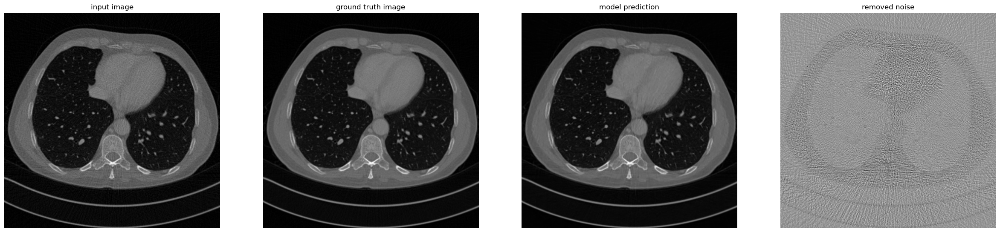







Model prediction test on blind images
10/10 [==============================] - 2s 168ms/step
datatype of patches :  float32
patches per image :  64
this image has start patches :  0
range of reconstructed image :  -0.006150650326162577 0.9948084354400635
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.06926513110743
SSIM of reconstructed image :  0.4959347


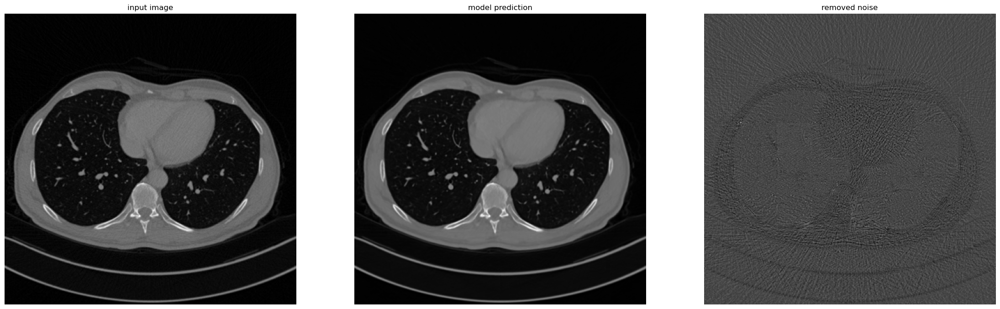

this image has start patches :  64
range of reconstructed image :  -0.006813067477196455 0.9875390529632568
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.086333938256878
SSIM of reconstructed image :  0.49761832


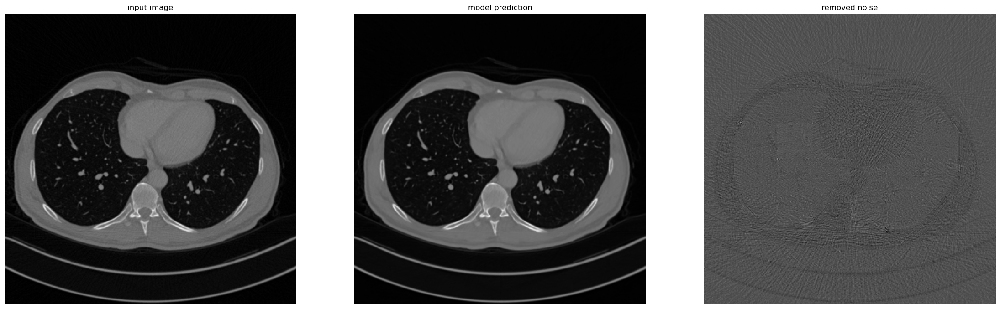

this image has start patches :  128
range of reconstructed image :  -0.006934926379472017 0.9839860200881958
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.092153060518665
SSIM of reconstructed image :  0.49783558


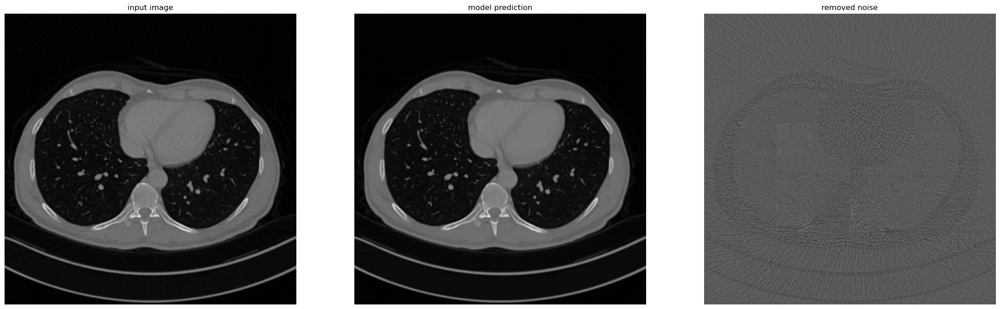

this image has start patches :  192
range of reconstructed image :  -0.005870324093848467 0.95383620262146
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.094518300425184
SSIM of reconstructed image :  0.49637288


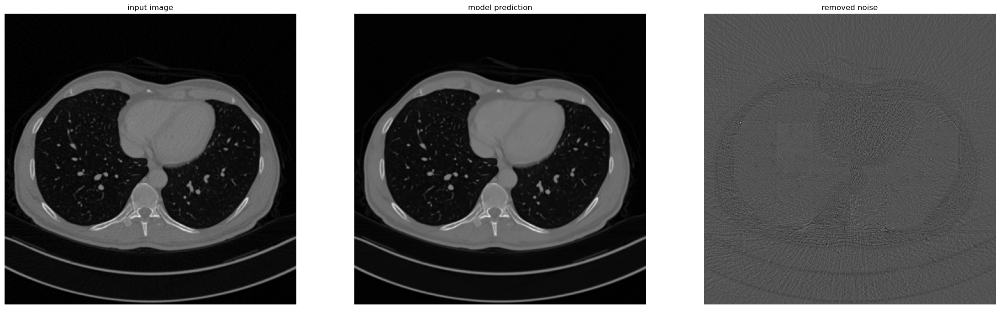

this image has start patches :  256
range of reconstructed image :  -0.003989348653703928 0.9444707632064819
reconstruct_image shape :  (512, 512, 1)
noisy image shape :  (512, 512, 1)
PSNR of reconsturcted image :  15.105736488334053
SSIM of reconstructed image :  0.49771062


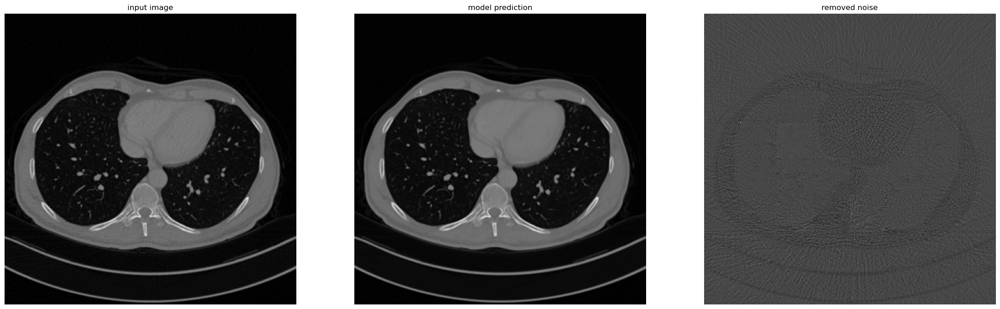

In [ ]:
from hformer_model_extended import get_hformer_model

# Get model and build (required for loading weights).
model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended_64_channel")
model.build(input_shape=(None, 64, 64, 1)) 
model.summary()

# We are required to set custom_objects since we are using custom loss function
loaded_model = model.load_weights('saved_weights_and_history/hformer_40_epoch_extended_64_channel.h5')
history = np.load('saved_weights_and_history/hformer_40_epoch_history_extended_64_channel.npy', allow_pickle=True).item()

evaluate_model(model, history, 'hformer_48_channel_medium_extended', 'psnr')